In [2]:
import sys
sys.path += ['../..']

import os

import tarfile
import json

import matplotlib.pyplot as plt

In [3]:
PATH_TO_CWL_DATA = '../data/structured/'
TAR_FILE_NAME = 'structured-2018-01-14-neworleans.tar.gz'

EVENT = 'structured-2018-01-14-neworleans/'
MATCH = 'structured-1515984523-6592b573-b485-58b0-963e-6be0b4d02f6c.json'

PATH_TO_WW2_MAPS = '../maps/ww2/'

MAP_IMAGES = {
    'Aachen': 'aachen.png',
    'Ardennes Forest': 'ardennes_forest.png',
    'Flak Tower': 'flaktower.png',
    'Gibraltar': 'gibraltar.png',
    'London Docks': 'london_docks.png',
    'Sainte Marie du Mont': 'sainte_marie_du_mont.png' ,
    'USS Texas': 'uss_texas.png',
    'Valkyrie': 'valkyrie.png'
}

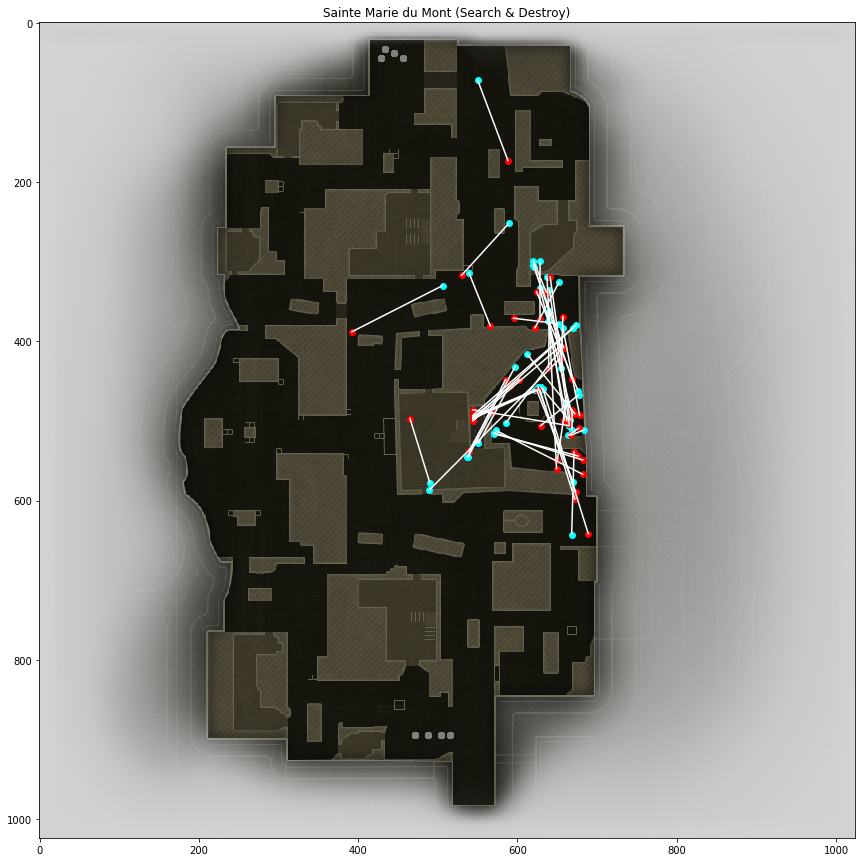

In [4]:
# extract match data from tarball
if not os.path.isfile('./{}{}'.format(EVENT, MATCH)):
    tar_file_name = PATH_TO_CWL_DATA + TAR_FILE_NAME
    tar = tarfile.open(tar_file_name)
    tar.extract(EVENT + MATCH)

# load match data and plot match events
with open('./{}{}'.format(EVENT, MATCH), 'r') as match_file:
    # get match data
    match = json.load(match_file)

    kill_pos, death_pos, spawn_pos = {'x': [], 'y': []}, {'x': [], 'y': []}, {'x': [], 'y': []}
    
    # get pos data
    events = match['events']
    for evt in events:
        if evt['type'] == 'spawn':
            spawn_pos['x'].append( evt['data']['pos']['x'] )
            spawn_pos['y'].append( evt['data']['pos']['y'] )
        if evt['type'] == 'death':
            kill_pos['x'].append( evt['data']['attacker']['pos']['x'] )
            kill_pos['y'].append( evt['data']['attacker']['pos']['y'] )
            death_pos['x'].append( evt['data']['pos']['x'] )
            death_pos['y'].append( evt['data']['pos']['y'] )

    # get map image
    map_file_name = PATH_TO_WW2_MAPS + MAP_IMAGES[match['map']]
    map_image = plt.imread(map_file_name)

    # create figure
    fig, ax = plt.subplots(1,1)
    fig.set_figheight(15)
    fig.set_figwidth(15)
    # plot map
    ax.imshow(map_image)
    ax.set_facecolor((210/255.0, 210/255.0, 210/255.0))
    # plot spawns
    ax.scatter(spawn_pos['x'], spawn_pos['y'], color='gray')
    # plot death events
    ax.scatter(kill_pos['x'], kill_pos['y'], color='cyan')
    ax.scatter(death_pos['x'], death_pos['y'], color='red')
    # plot kill vectors
    for i in range( len(kill_pos['x']) ):
        plt.plot([kill_pos['x'][i], death_pos['x'][i]], [kill_pos['y'][i], death_pos['y'][i]], color='white')
    # set title
    ax.set_title('{} ({})'.format(match['map'], match['mode']))

In [5]:
import os, json
import pandas as pd

PATH_TO_CWL_DATA = '../data/structured/'
TAR_FILE_NAME = 'structured-2018-01-14-neworleans.tar.gz'

EVENT = 'structured-2018-01-14-neworleans/'
MATCH = 'structured-2018-01-14-neworleans/'

neworleans_files = [pos_json for pos_json in os.listdir('structured-2018-01-14-neworleans/') if pos_json.endswith('.json')]
#print(json_files)  # for me this prints ['foo.json']

PATH_TO_WW2_MAPS = '../maps/ww2/'

MAP_IMAGES = {
    'Aachen': 'aachen.png',
    'Ardennes Forest': 'ardennes_forest.png',
    'Flak Tower': 'flaktower.png',
    'Gibraltar': 'gibraltar.png',
    'London Docks': 'london_docks.png',
    'Sainte Marie du Mont': 'sainte_marie_du_mont.png' ,
    'USS Texas': 'uss_texas.png',
    'Valkyrie': 'valkyrie.png'
}

len(neworleans_files)

280

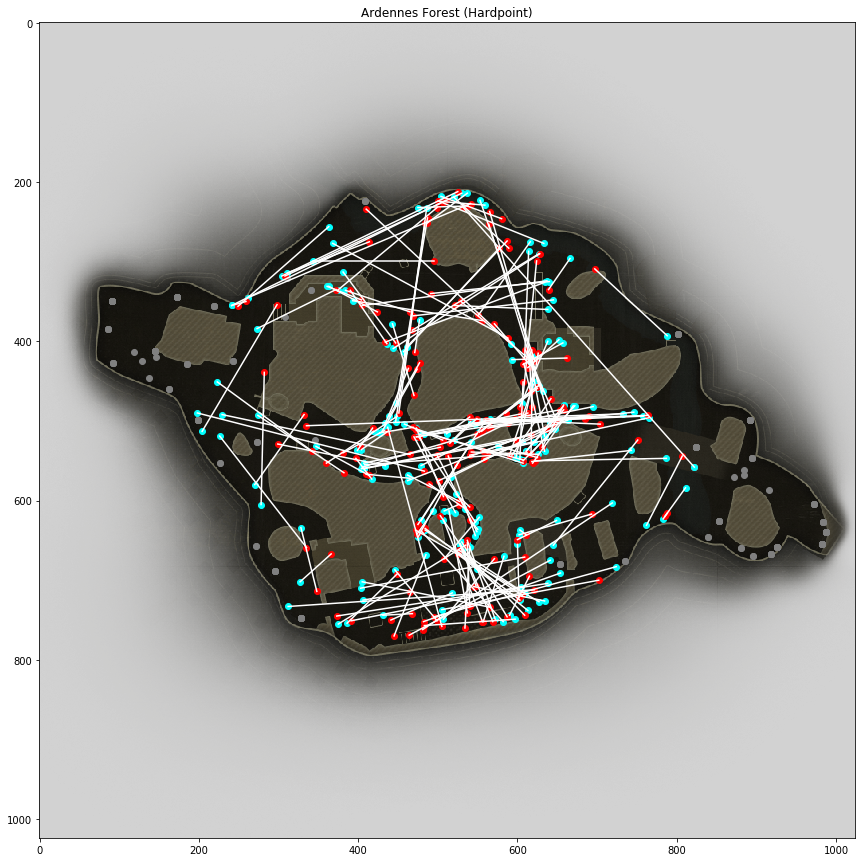

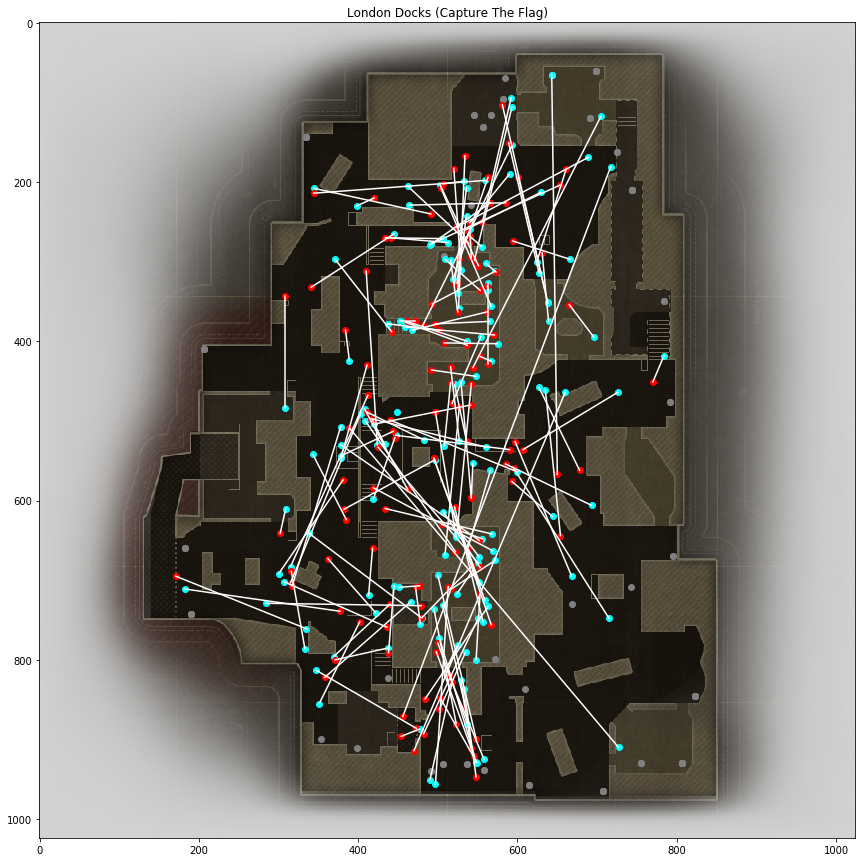

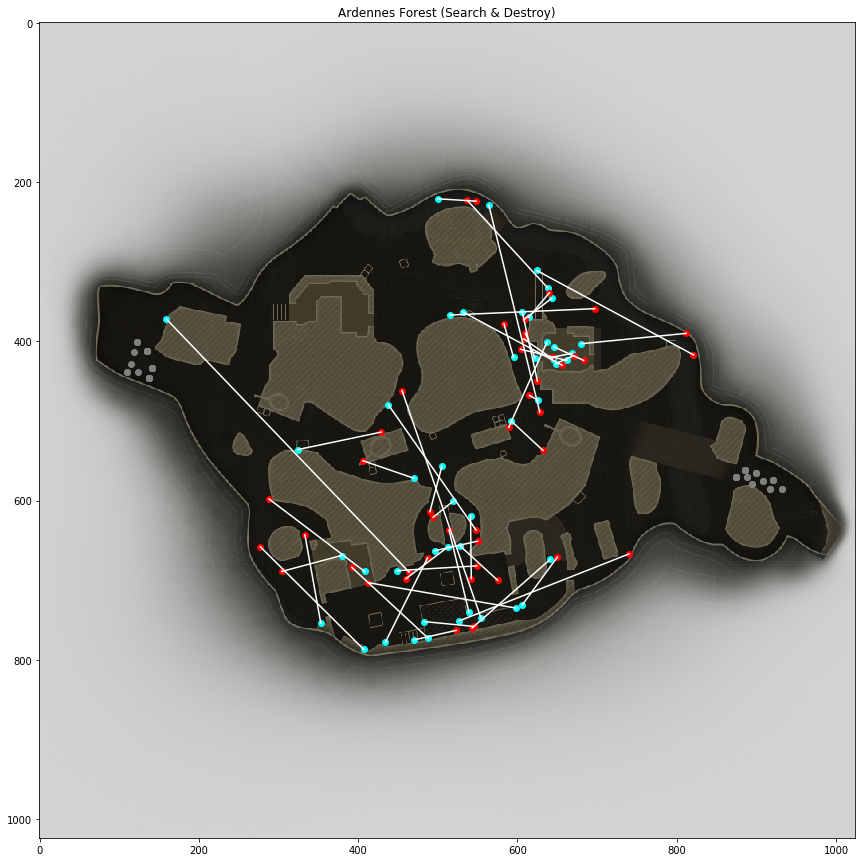

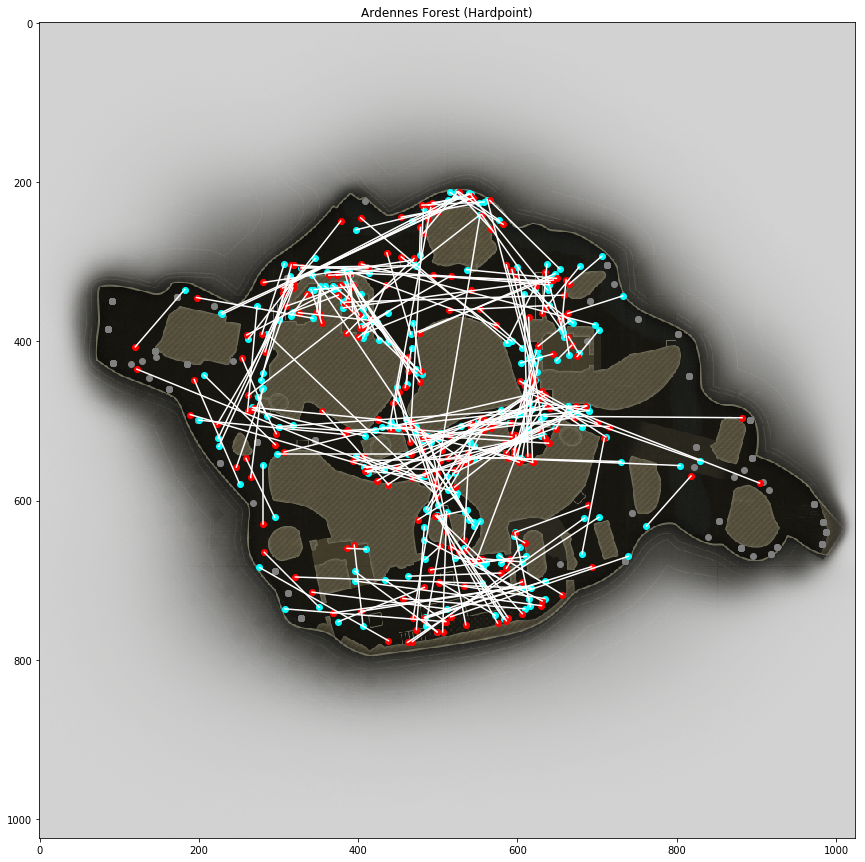

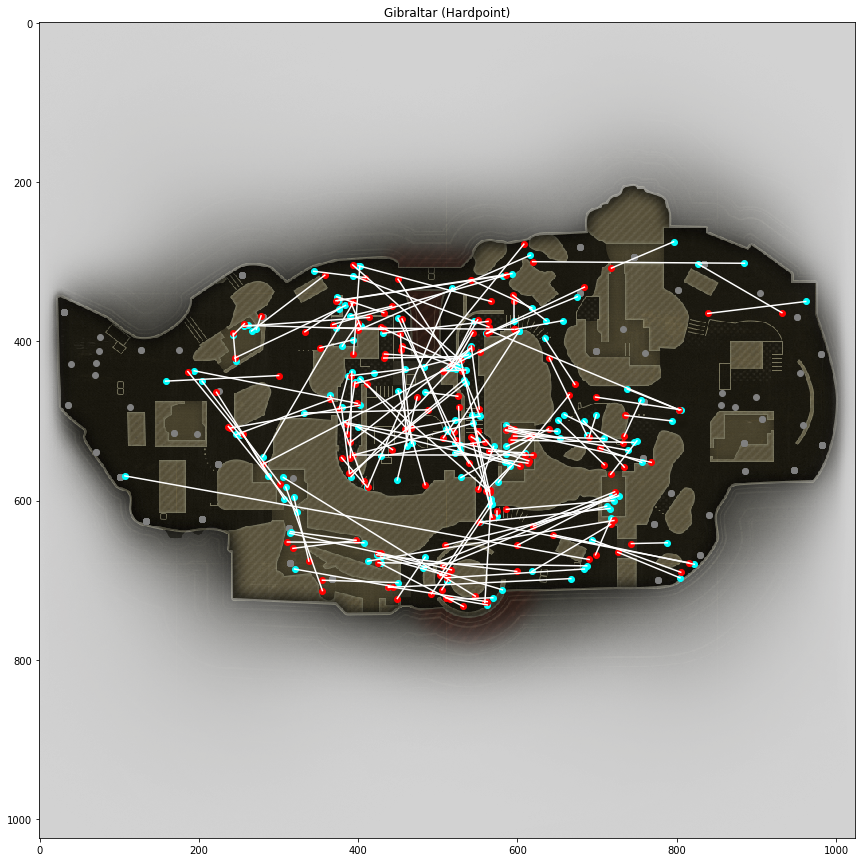

...

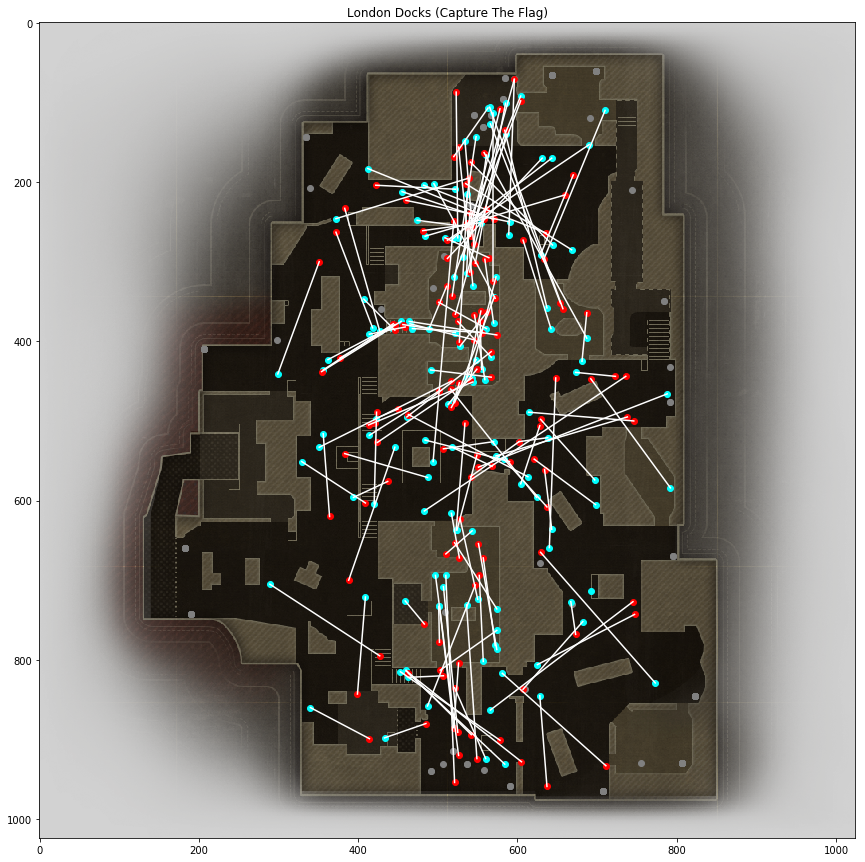

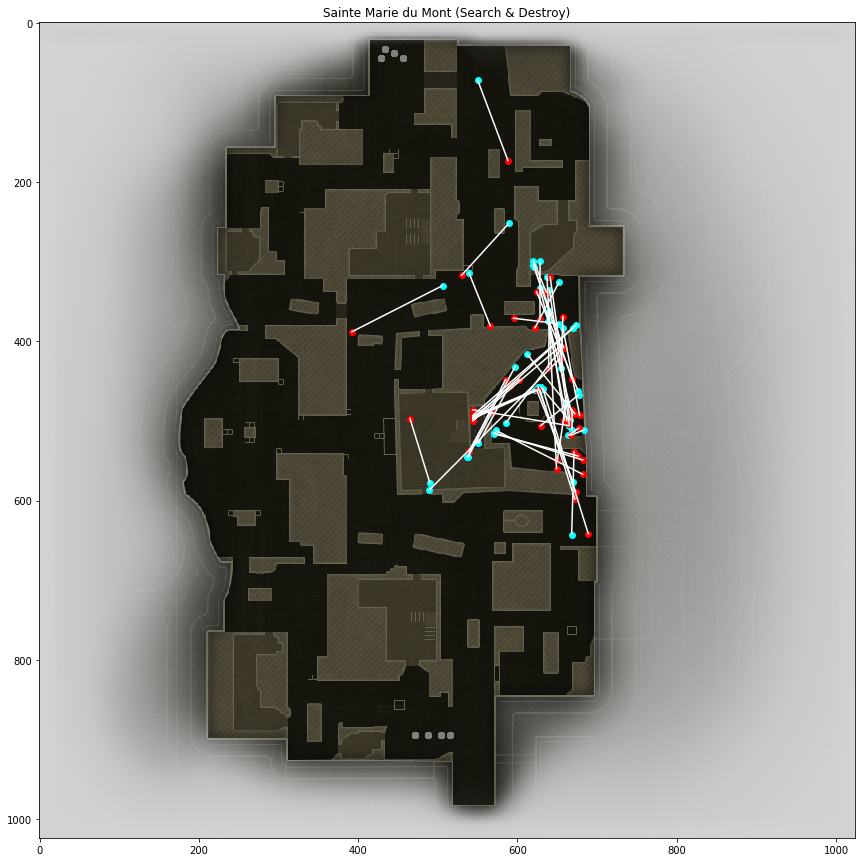

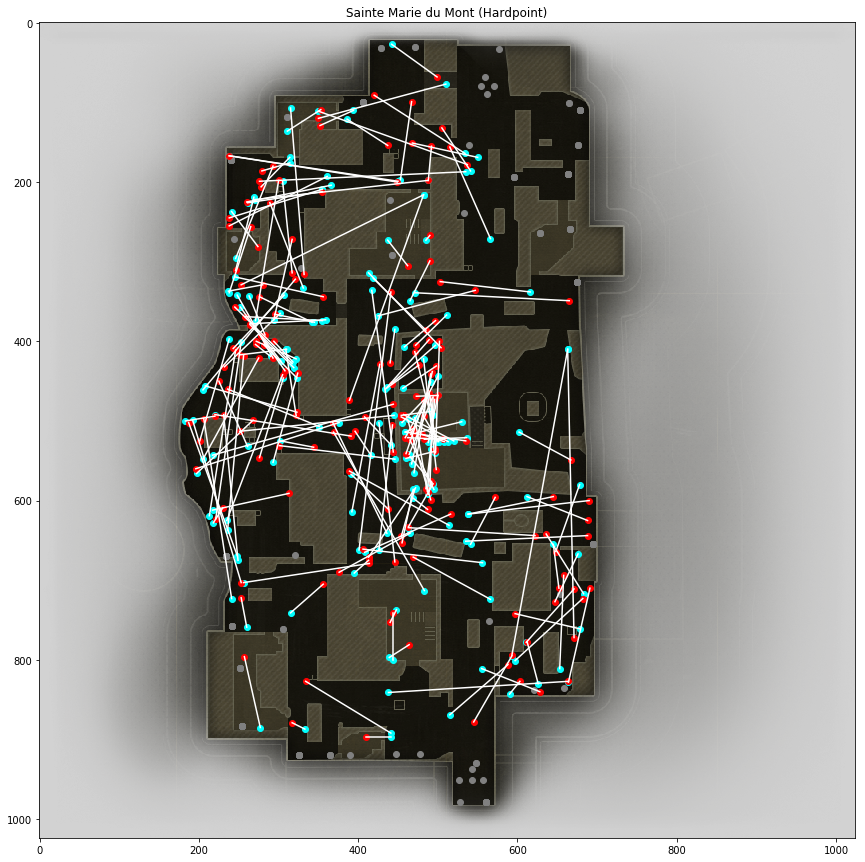

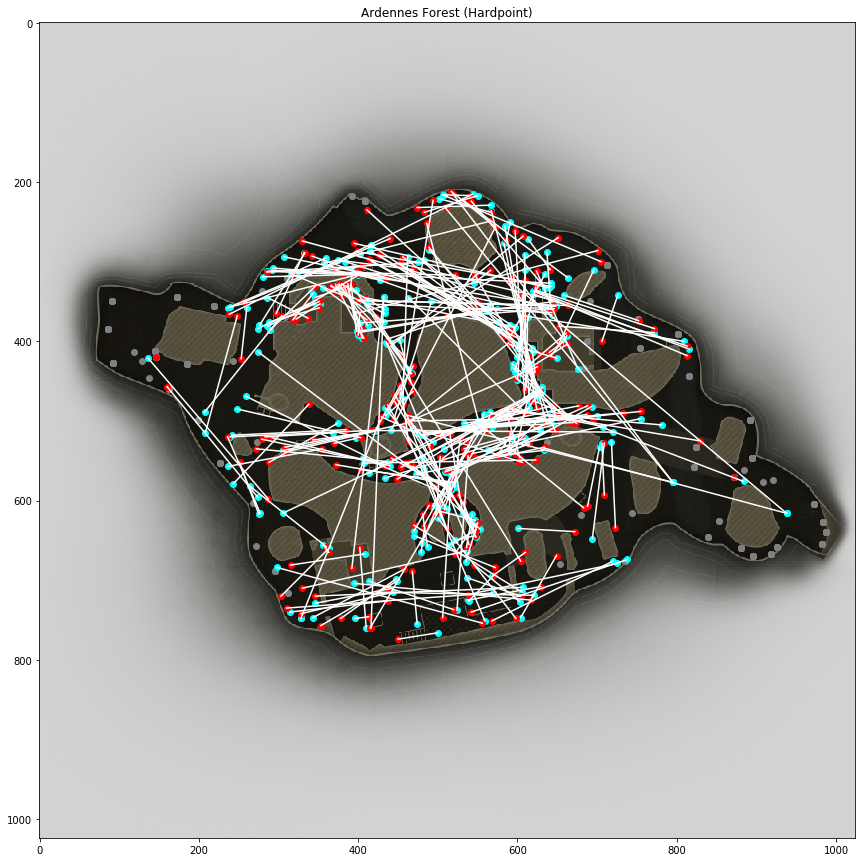

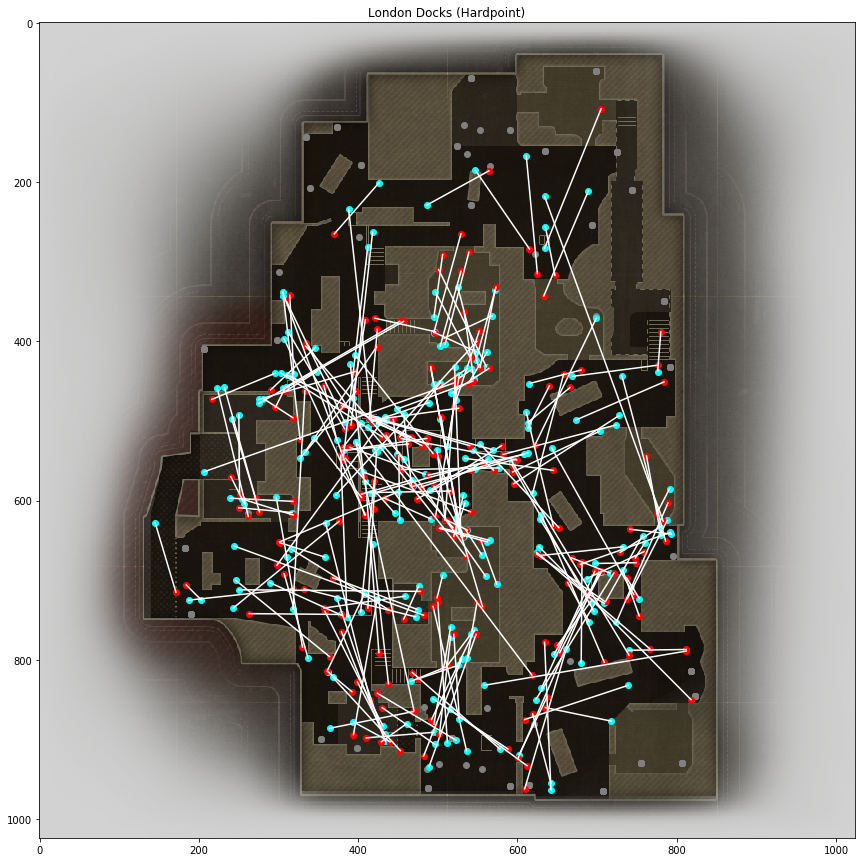

In [6]:
# extract match data from tarball

for i in range(len(neworleans_files)):

    if not os.path.isfile('./{}{}'.format(EVENT, MATCH)):
        tar_file_name = PATH_TO_CWL_DATA + TAR_FILE_NAME
        tar = tarfile.open(tar_file_name)
        tar.extract(EVENT + neworleans_files[i])

    # load match data and plot match events
    with open('./{}{}'.format(EVENT, neworleans_files[i]), 'r') as match_file:
        # get match data
        match = json.load(match_file)

        kill_pos, death_pos, spawn_pos = {'x': [], 'y': []}, {'x': [], 'y': []}, {'x': [], 'y': []}

        # get pos data
        events = match['events']
        for evt in events:
            if evt['type'] == 'spawn':
                spawn_pos['x'].append( evt['data']['pos']['x'] )
                spawn_pos['y'].append( evt['data']['pos']['y'] )
            if evt['type'] == 'death':
                kill_pos['x'].append( evt['data']['attacker']['pos']['x'] )
                kill_pos['y'].append( evt['data']['attacker']['pos']['y'] )
                death_pos['x'].append( evt['data']['pos']['x'] )
                death_pos['y'].append( evt['data']['pos']['y'] )

        # get map image
        map_file_name = PATH_TO_WW2_MAPS + MAP_IMAGES[match['map']]
        map_image = plt.imread(map_file_name)

        # create figure
        fig, ax = plt.subplots(1,1)
        fig.set_figheight(15)
        fig.set_figwidth(15)
        # plot map
        ax.imshow(map_image)
        ax.set_facecolor((210/255.0, 210/255.0, 210/255.0))
        # plot spawns
        ax.scatter(spawn_pos['x'], spawn_pos['y'], color='gray')
        # plot death events
        ax.scatter(kill_pos['x'], kill_pos['y'], color='cyan')
        ax.scatter(death_pos['x'], death_pos['y'], color='red')
        # plot kill vectors
        for i in range( len(kill_pos['x']) ):
            plt.plot([kill_pos['x'][i], death_pos['x'][i]], [kill_pos['y'][i], death_pos['y'][i]], color='white')
        # set title
        ax.set_title('{} ({})'.format(match['map'], match['mode']))

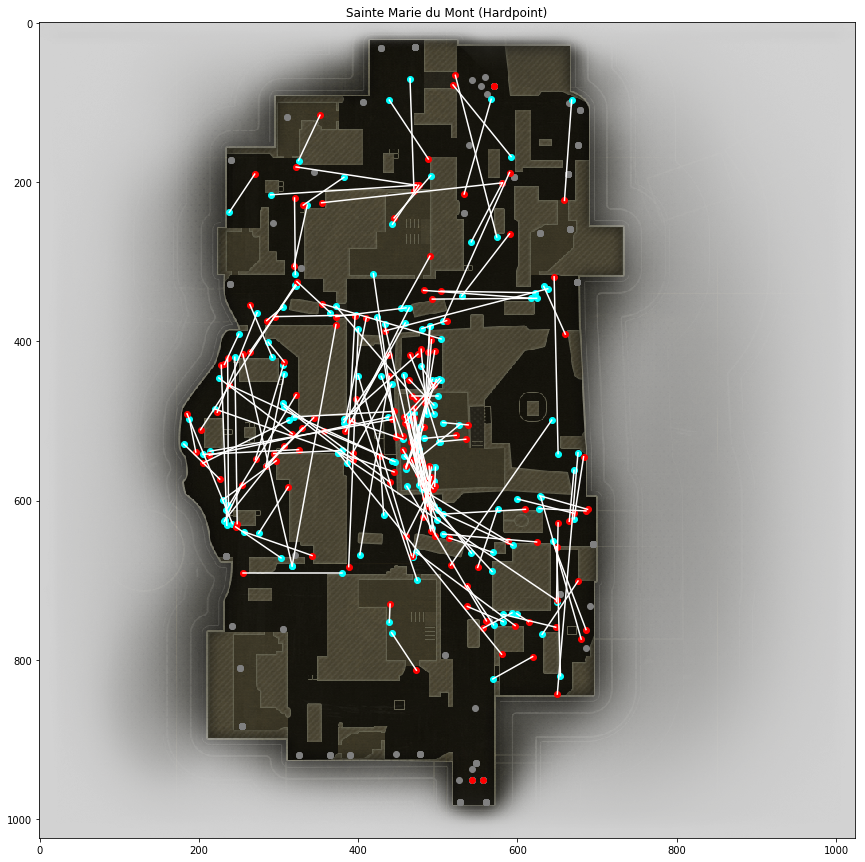

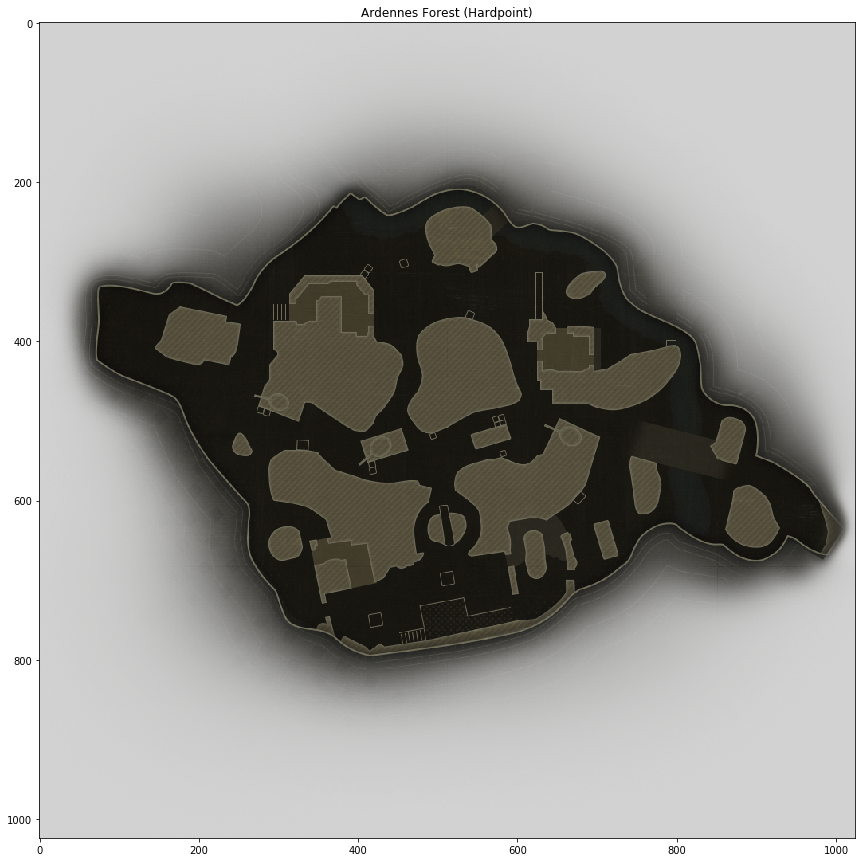

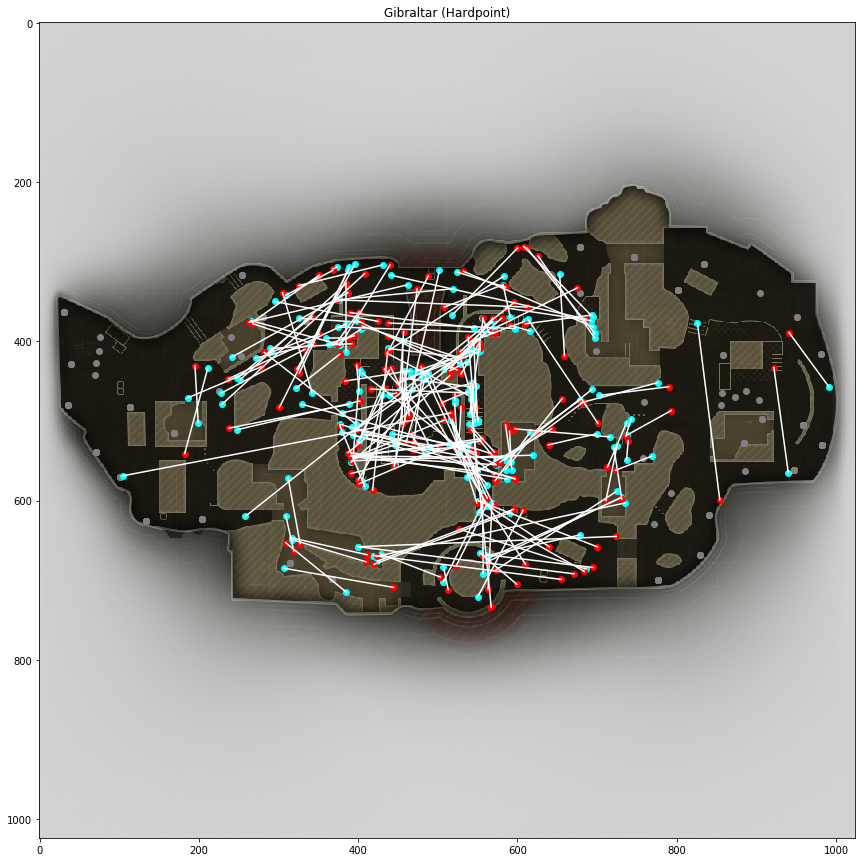

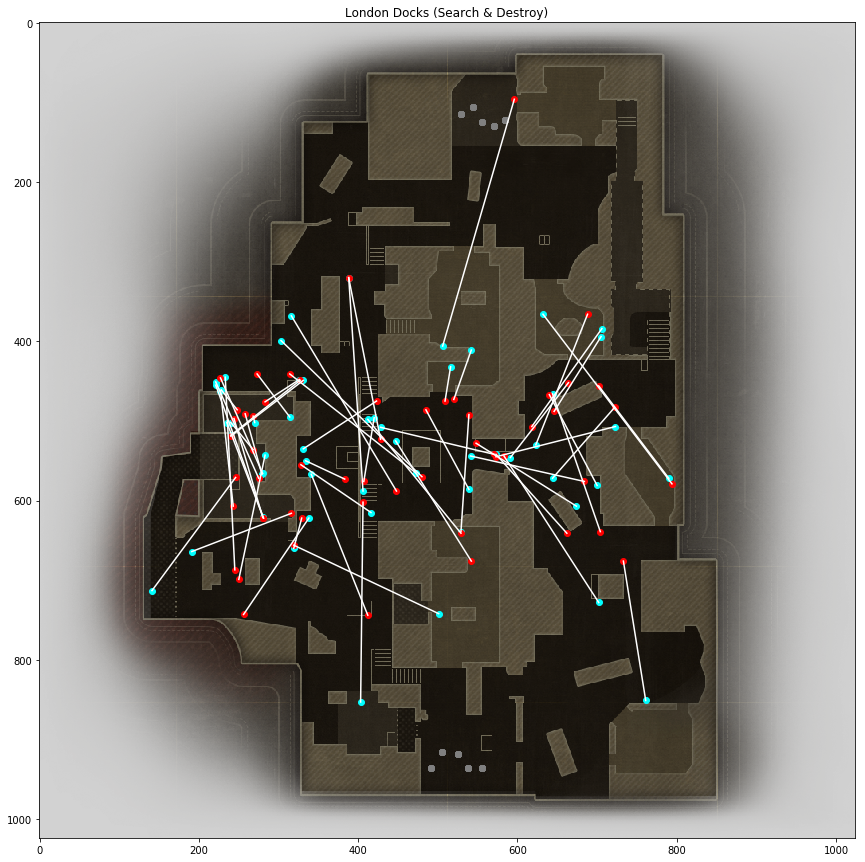

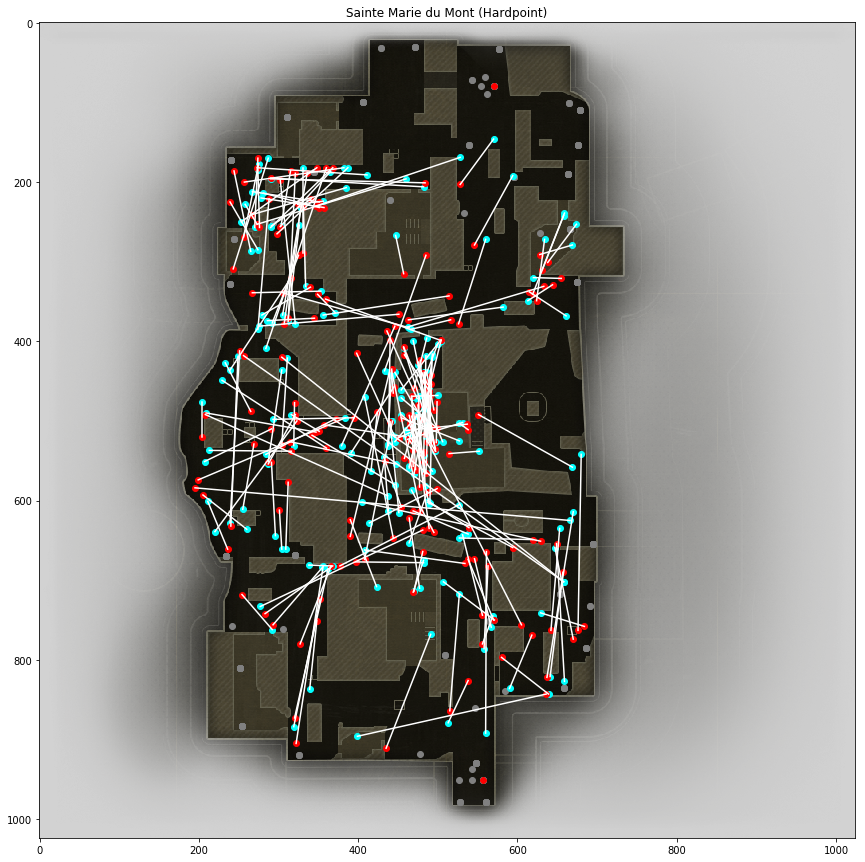

In [9]:
TAR_FILE_NAME = 'structured-2018-03-11-atlanta.tar.gz'

EVENT = 'structured-2018-03-11-atlanta/'
MATCH = 'structured-2018-03-11-atlanta/'

atlanta_files = [pos_json for pos_json in os.listdir('structured-2018-03-11-atlanta/') if pos_json.endswith('.json')]
#print(json_files)  # for me this prints ['foo.json']

len(atlanta_files)

for i in range(len(atlanta_files)):

    if not os.path.isfile('./{}{}'.format(EVENT, MATCH)):
        tar_file_name = PATH_TO_CWL_DATA + TAR_FILE_NAME
        tar = tarfile.open(tar_file_name)
        tar.extract(EVENT + atlanta_files[i])

    # load match data and plot match events
    with open('./{}{}'.format(EVENT, atlanta_files[i]), 'r') as match_file:
        # get match data
        match = json.load(match_file)

        kill_pos, death_pos, spawn_pos = {'x': [], 'y': []}, {'x': [], 'y': []}, {'x': [], 'y': []}

        # get pos data
        events = match['events']
        for evt in events:
            if evt['type'] == 'spawn':
                spawn_pos['x'].append( evt['data']['pos']['x'] )
                spawn_pos['y'].append( evt['data']['pos']['y'] )
            if evt['type'] == 'death':
                kill_pos['x'].append( evt['data']['attacker']['pos']['x'] )
                kill_pos['y'].append( evt['data']['attacker']['pos']['y'] )
                death_pos['x'].append( evt['data']['pos']['x'] )
                death_pos['y'].append( evt['data']['pos']['y'] )

        # get map image
        map_file_name = PATH_TO_WW2_MAPS + MAP_IMAGES[match['map']]
        map_image = plt.imread(map_file_name)

        # create figure
        fig, ax = plt.subplots(1,1)
        fig.set_figheight(15)
        fig.set_figwidth(15)
        # plot map
        ax.imshow(map_image)
        ax.set_facecolor((210/255.0, 210/255.0, 210/255.0))
        # plot spawns
        ax.scatter(spawn_pos['x'], spawn_pos['y'], color='gray')
        # plot death events
        ax.scatter(kill_pos['x'], kill_pos['y'], color='cyan')
        ax.scatter(death_pos['x'], death_pos['y'], color='red')
        # plot kill vectors
        for i in range( len(kill_pos['x']) ):
            plt.plot([kill_pos['x'][i], death_pos['x'][i]], [kill_pos['y'][i], death_pos['y'][i]], color='white')
        # set title
        ax.set_title('{} ({})'.format(match['map'], match['mode']))
        


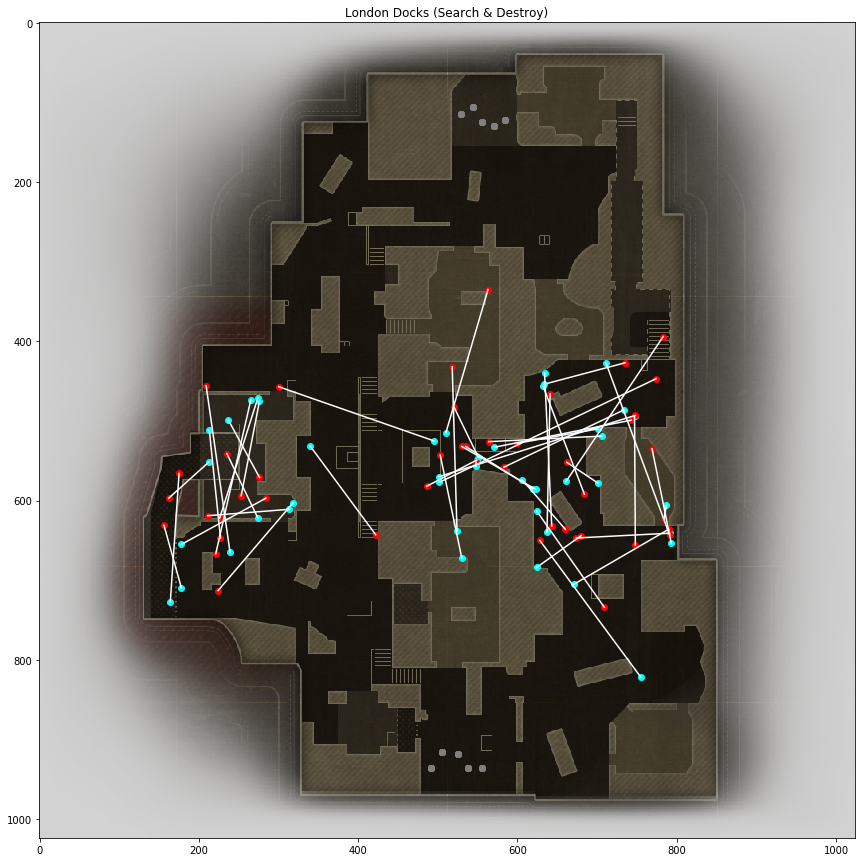

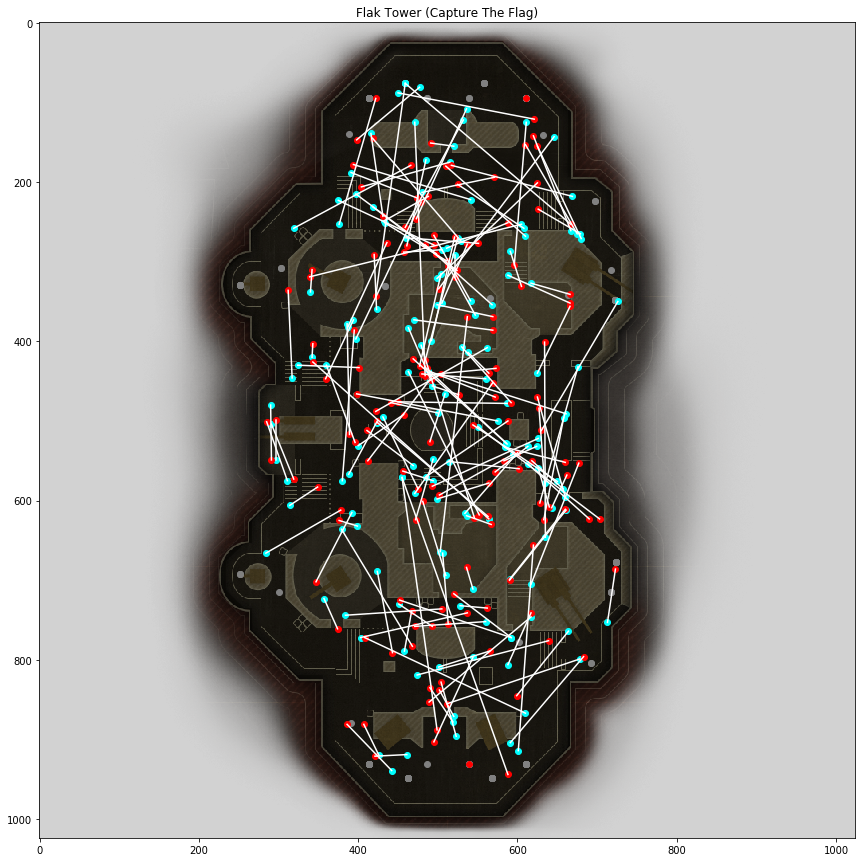

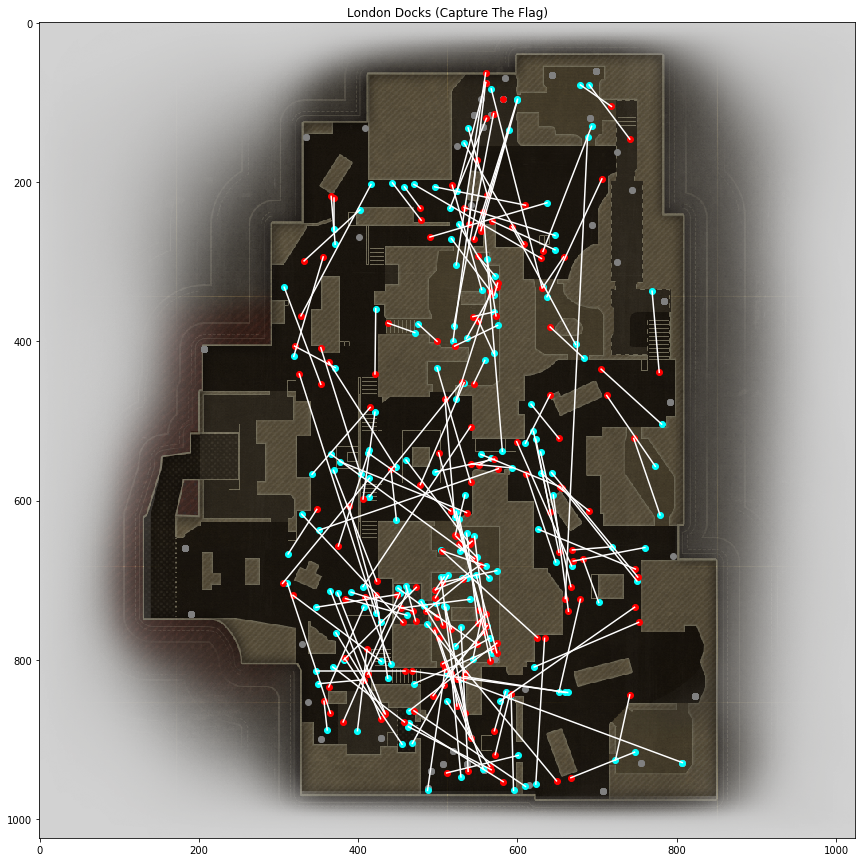

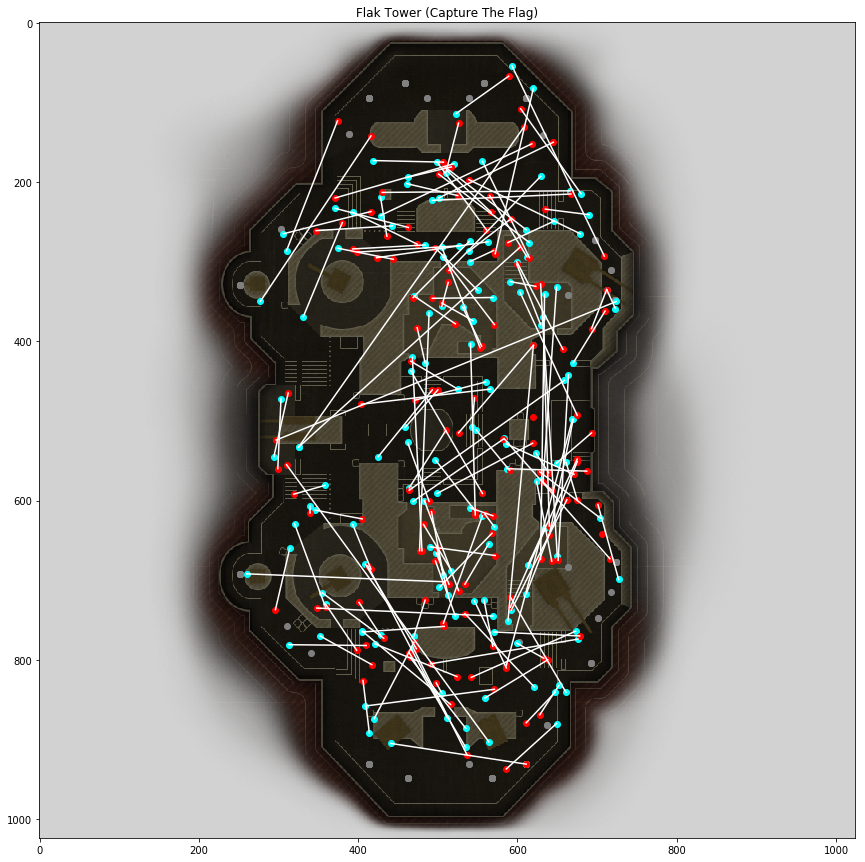

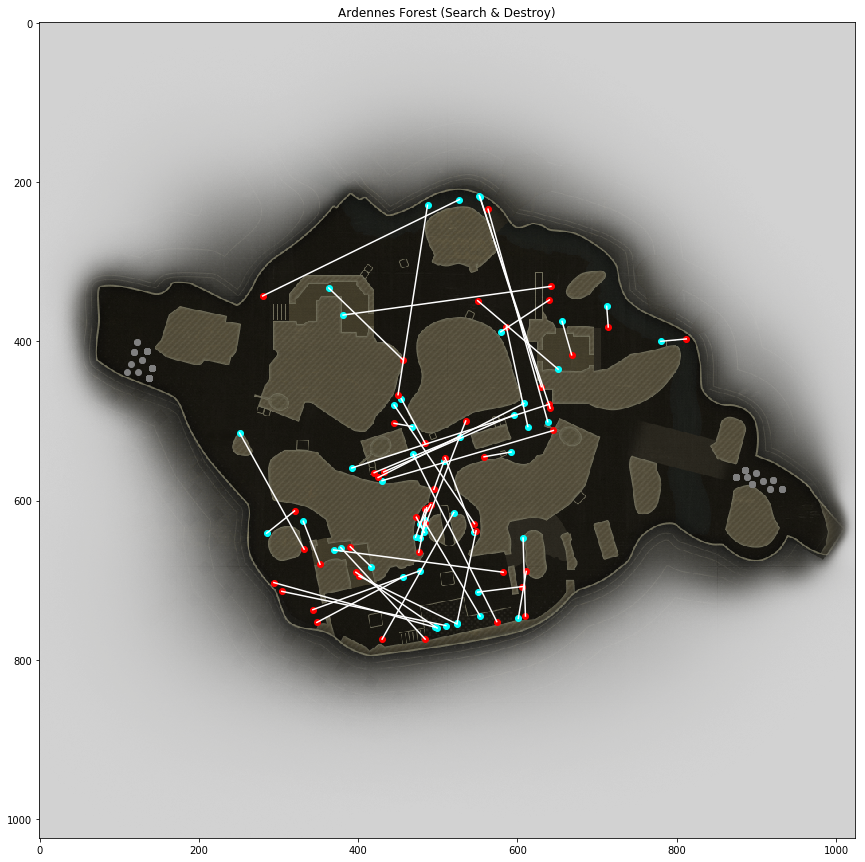

In [10]:
TAR_FILE_NAME = 'structured-2018-04-01-birmingham.tar.gz'

EVENT = 'structured-2018-04-01-birmingham/'
MATCH = 'structured-2018-04-01-birmingham/'

birmingham_files = [pos_json for pos_json in os.listdir('structured-2018-04-01-birmingham/') if pos_json.endswith('.json')]
#print(json_files)  # for me this prints ['foo.json']

len(birmingham_files)

for i in range(len(birmingham_files)):

    if not os.path.isfile('./{}{}'.format(EVENT, MATCH)):
        tar_file_name = PATH_TO_CWL_DATA + TAR_FILE_NAME
        tar = tarfile.open(tar_file_name)
        tar.extract(EVENT + birmingham_files[i])

    # load match data and plot match events
    with open('./{}{}'.format(EVENT, birmingham_files[i]), 'r') as match_file:
        # get match data
        match = json.load(match_file)

        kill_pos, death_pos, spawn_pos = {'x': [], 'y': []}, {'x': [], 'y': []}, {'x': [], 'y': []}

        # get pos data
        events = match['events']
        for evt in events:
            if evt['type'] == 'spawn':
                spawn_pos['x'].append( evt['data']['pos']['x'] )
                spawn_pos['y'].append( evt['data']['pos']['y'] )
            if evt['type'] == 'death':
                kill_pos['x'].append( evt['data']['attacker']['pos']['x'] )
                kill_pos['y'].append( evt['data']['attacker']['pos']['y'] )
                death_pos['x'].append( evt['data']['pos']['x'] )
                death_pos['y'].append( evt['data']['pos']['y'] )

        # get map image
        map_file_name = PATH_TO_WW2_MAPS + MAP_IMAGES[match['map']]
        map_image = plt.imread(map_file_name)

        # create figure
        fig, ax = plt.subplots(1,1)
        fig.set_figheight(15)
        fig.set_figwidth(15)
        # plot map
        ax.imshow(map_image)
        ax.set_facecolor((210/255.0, 210/255.0, 210/255.0))
        # plot spawns
        ax.scatter(spawn_pos['x'], spawn_pos['y'], color='gray')
        # plot death events
        ax.scatter(kill_pos['x'], kill_pos['y'], color='cyan')
        ax.scatter(death_pos['x'], death_pos['y'], color='red')
        # plot kill vectors
        for i in range( len(kill_pos['x']) ):
            plt.plot([kill_pos['x'][i], death_pos['x'][i]], [kill_pos['y'][i], death_pos['y'][i]], color='white')
        # set title
        ax.set_title('{} ({})'.format(match['map'], match['mode']))
        

In [ ]:
TAR_FILE_NAME = 'structured-2018-04-01-birmingham.tar.gz'

EVENT = 'structured-2018-04-01-birmingham/'
MATCH = 'structured-2018-04-01-birmingham/'

birmingham_files = [pos_json for pos_json in os.listdir('structured-2018-04-01-birmingham/') if pos_json.endswith('.json')]
#print(json_files)  # for me this prints ['foo.json']

len(birmingham_files)

for i in range(len(birmingham_files)):

    if not os.path.isfile('./{}{}'.format(EVENT, MATCH)):
        tar_file_name = PATH_TO_CWL_DATA + TAR_FILE_NAME
        tar = tarfile.open(tar_file_name)
        tar.extract(EVENT + birmingham_files[i])

    # load match data and plot match events
    with open('./{}{}'.format(EVENT, birmingham_files[i]), 'r') as match_file:
        # get match data
        match = json.load(match_file)

        kill_pos, death_pos, spawn_pos = {'x': [], 'y': []}, {'x': [], 'y': []}, {'x': [], 'y': []}

        # get pos data
        events = match['events']
        for evt in events:
            if evt['type'] == 'spawn':
                spawn_pos['x'].append( evt['data']['pos']['x'] )
                spawn_pos['y'].append( evt['data']['pos']['y'] )
            if evt['type'] == 'death':
                kill_pos['x'].append( evt['data']['attacker']['pos']['x'] )
                kill_pos['y'].append( evt['data']['attacker']['pos']['y'] )
                death_pos['x'].append( evt['data']['pos']['x'] )
                death_pos['y'].append( evt['data']['pos']['y'] )

        # get map image
        map_file_name = PATH_TO_WW2_MAPS + MAP_IMAGES[match['map']]
        map_image = plt.imread(map_file_name)

        # create figure
        fig, ax = plt.subplots(1,1)
        fig.set_figheight(15)
        fig.set_figwidth(15)
        # plot map
        ax.imshow(map_image)
        ax.set_facecolor((210/255.0, 210/255.0, 210/255.0))
        # plot spawns
        ax.scatter(spawn_pos['x'], spawn_pos['y'], color='gray')
        # plot death events
        ax.scatter(kill_pos['x'], kill_pos['y'], color='cyan')
        ax.scatter(death_pos['x'], death_pos['y'], color='red')
        # plot kill vectors
        for i in range( len(kill_pos['x']) ):
            plt.plot([kill_pos['x'][i], death_pos['x'][i]], [kill_pos['y'][i], death_pos['y'][i]], color='white')
        # set title
        ax.set_title('{} ({})'.format(match['map'], match['mode']))
        